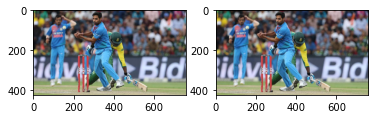

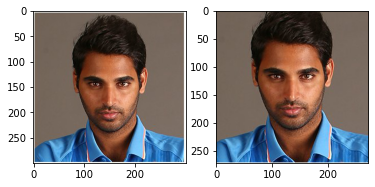

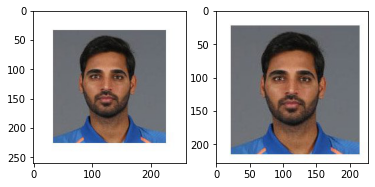

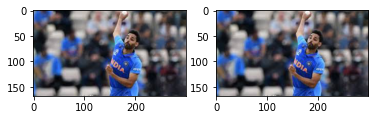

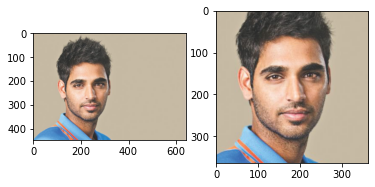

...

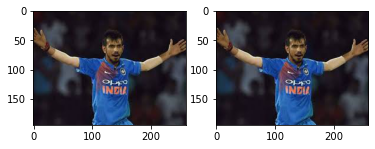

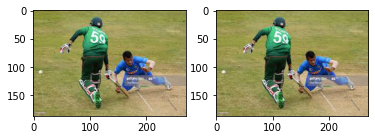

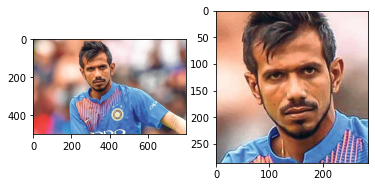

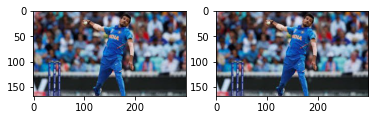

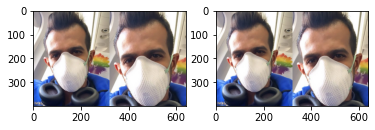

In [1]:
from matplotlib import pyplot as plt
import cv2
import os
dir = './images/'
dir_final = './faces/'

face_cascade = cv2.CascadeClassifier('haarcascade.xml')

for players in os.listdir(dir):
    os.mkdir(dir_final+players)
    for image in os.listdir(dir+players):
        loc = dir+players+'/'+image
        img = cv2.imread(loc)
        img2 = img.copy()
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        faces = face_cascade.detectMultiScale(gray,1.3,5)
        for (x,y,w,h) in faces:
            img2 = img2[y-60:y+h+60, x-60:x+w+60]
        loc2 = dir_final+players+'/'+image
        if img2.shape[0] <50 or img2.shape[1] <50:
            continue
        plt.subplot(1,2,1)
        plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
        plt.subplot(1,2,2)
        plt.imshow(cv2.cvtColor(img2,cv2.COLOR_BGR2RGB))
        plt.show()
        cv2.imwrite(loc2,img2)

In [2]:
import os
import shutil
import numpy as np
source1 = "./faces/"
dest1 = "./testSet/"
dest2 = "./trainSet/"
for player in os.listdir(source1):
    os.mkdir(dest1+player)
    os.mkdir(dest2+player)
    for image in os.listdir(source1+player):
        if np.random.rand(1) < 0.2:
            shutil.copy(source1 + player + '/'+ image, dest1 + player+'/'+ image)
        else:
            shutil.copy(source1 + player + '/'+ image, dest2 + player+'/'+ image)